<a href="https://colab.research.google.com/github/rameshavinash94/Regression_Retail_Store/blob/main/Regression_CLassificaiton_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Olist store Retail Analysis**

**Our Business Problem:**

**Regression Problem:**
Predicting Delivery Date/Freight cost for product. Predicting the Delivery date/freight cost of a product based on various factors like zip code, distance,seller score,transportation, etc.

**Clasification Problem:**
Classifiing product category type based on product dimensions,price,freight cost and multiple factors.

#### **IMPORTING LIBRARIES**

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import plotly.express as px
from sklearn.cluster import AgglomerativeClustering

**Load the datasets**

In [3]:
customers = pd.read_csv('olist_customers_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')
order_payment= pd.read_csv('olist_order_payments_dataset.csv')
geolocation = pd.read_csv('olist_geolocation_dataset.csv')
order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
orders = pd.read_csv('olist_orders_dataset.csv')
products = pd.read_csv('olist_products_dataset.csv')
sellers = pd.read_csv('olist_sellers_dataset.csv')
product_category_name = pd.read_csv('product_category_name_translation.csv')

The ER/Data Modeling Structure of the Datasource
<div>
<img src='https://i.imgur.com/HRhd2Y0.png'>
</div>


**LOCATION DATASET**

In [4]:
#groupby zipcodes
location_info = geolocation.groupby('geolocation_zip_code_prefix').max().drop_duplicates().reset_index()

In [5]:
#view the dataframe
location_info

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1001,-23.549292,-46.633559,são paulo,SP
1,1002,-23.544641,-46.633180,são paulo,SP
2,1003,-23.548901,-46.634862,são paulo,SP
3,1004,-23.549181,-46.634057,são paulo,SP
4,1005,-23.548758,-46.634768,são paulo,SP
...,...,...,...,...,...
18993,99960,-27.953409,-52.016483,charrua,RS
18994,99965,-28.173892,-52.034367,agua santa,RS
18995,99970,-28.341329,-51.870397,ciríaco,RS
18996,99980,-28.386239,-51.779942,david canabarro,RS


In [6]:
#join with customers dataset
customers_location=pd.merge(customers,location_info,left_on='customer_zip_code_prefix',right_on='geolocation_zip_code_prefix').drop(columns=['geolocation_zip_code_prefix','geolocation_city','geolocation_state','customer_unique_id']).rename(columns={'geolocation_lat':'customer_lat','geolocation_lng':'customer_lng'})

In [7]:
#view dataframe
customers_location.head()

,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,customer_lng
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409,franca,SP,-20.468849,-47.382173
1,5dca924cc99eea2dc5ba40d11ec5dd0f,14409,franca,SP,-20.468849,-47.382173
2,661897d4968f1b59bfff74c7eb2eb4fc,14409,franca,SP,-20.468849,-47.382173
3,702b62324327ccba20f1be3465426437,14409,franca,SP,-20.468849,-47.382173
4,bdf997bae7ca819b0415f5174d6b4302,14409,franca,SP,-20.468849,-47.382173


In [8]:
#join with sellers dataset
seller_locations=pd.merge(sellers,location_info,left_on='seller_zip_code_prefix',right_on='geolocation_zip_code_prefix').drop(columns=['geolocation_zip_code_prefix','geolocation_city','geolocation_state']).rename(columns={'geolocation_lat':'seller_lat','geolocation_lng':'seller_lng'})

In [9]:
#view dataframe
seller_locations.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state,seller_lat,seller_lng
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,-22.884842,-47.045846
1,e0eabded302882513ced4ea3eb0c7059,13023,campinas,SP,-22.884842,-47.045846
2,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP,-22.347646,-46.920804
3,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ,-22.864365,-43.170800
4,1d2732ef8321502ee8488e8bed1ab8cd,20031,rio de janeiro,RJ,-22.864365,-43.170800


In [10]:
#view orders dataframe
orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [11]:
#view order_review dataframe
order_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


**Perform Multiple joins to get the final resultant dataframe**

In [12]:
product_info = pd.merge(order_items,products)

In [13]:
product_info = pd.merge(product_info,product_category_name)

In [14]:
order_product_info= pd.merge(orders,product_info)

In [15]:
customers_orders=pd.merge(customers_location,order_product_info)

In [16]:
final_Df = pd.merge(customers_orders,seller_locations)

In [17]:
final_Df = final_Df[final_Df['order_status']=='delivered']

**FUNCTION TO FIND DISTANCE BETWEEN 2 GEO LOCATIONS**

In [18]:
def haversine_distance(lat1, lon1, lat2, lon2):
   r = 6371
   phi1 = np.radians(lat1)
   phi2 = np.radians(lat2)
   delta_phi = np.radians(np.array(lat2) - np.array(lat1))
   delta_lambda = np.radians(np.array(lon2) - np.array(lon1))
   a = np.sin(delta_phi / 2)**2 + np.cos(phi1) * np.cos(phi2) *   np.sin(delta_lambda / 2)**2
   res = r * (2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a)))
   return np.round(res*0.6214, 2)

In [19]:
final_Df['distance']= haversine_distance(final_Df['customer_lat'],final_Df['customer_lng'],final_Df['seller_lat'],final_Df['seller_lng'])

In [20]:
#VIEW THE DATAFRAME
final_Df.head()

,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,customer_lng,order_id,order_status,order_purchase_timestamp,order_approved_at,...,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state,seller_lat,seller_lng,distance
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409,franca,SP,-20.468849,-47.382173,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,...,54.0,64.0,31.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,218.13
1,4e7b3e00288586ebd08712fdd0374a03,1151,sao paulo,SP,-23.527788,-46.652997,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,...,52.0,52.0,17.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,19.00
2,b2b6027bc5c5109e529d4dc6358b12c3,8775,mogi das cruzes,SP,-23.493944,-46.172406,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,...,56.0,51.0,28.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,11.79
3,f2fdb2409d1c2b5018b19767572978d6,30575,belo horizonte,MG,-19.818637,-43.929691,930fb714ff2992c4ff14bf920af830e6,delivered,2017-12-03 14:52:12,2017-12-03 14:59:22,...,57.0,55.0,22.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,297.14
4,bf45a4524fffba803efa07f225cdfda5,20231,rio de janeiro,RJ,-22.908714,-43.182574,22167b7870f3c3b844087c5cbafac521,delivered,2018-03-07 17:56:08,2018-03-09 02:30:55,...,57.0,55.0,22.0,office_furniture,8577,itaquaquecetuba,SP,-23.479473,-46.357851,205.48


In [21]:
#VIEW THE COLUMNS
final_Df.columns

Index(['customer_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'customer_lat', 'customer_lng', 'order_id',
       'order_status', 'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'seller_lat', 'seller_lng', 'distance'],
      dtype='object')

**Now Create Multiple Time Based Features For The Current Usecase**


**Actual Delivery Timeline** = _Difference in days between order_delivered_customer_date & order_purchase_timestamp._

**Estimated_delivery_timeline** = _Difference in days between order_delivered_customer_date & order_estimated_delivery_date if diff is less/zero then the customer is happy._

**Seller_approval_timeline** = _Difference in days between order_approved_at & order_purchase_timestamp. If the order gets approved faster then most probably the item is in stock and has higher chance of reaching on time._

**Seller_processing_timeline**  = _Difference in days between order_delivered_carrier_date & order_approved_at. Time taken by the seller to process the order._

**Seller_order_timeline** = _Difference in days between order_delivered_carrier_date & shipping_limit_date. if diff is less than seller is on track with the order._

**Carrier_delivery_timeline** = _Difference in days between order_delivered_customer_date & order_delivered_carrier_date. Time taken by the carrier to delive the order to the customer._

In [22]:
#creating new features
final_Df[['order_delivered_customer_date','order_purchase_timestamp','order_estimated_delivery_date','order_approved_at','order_delivered_carrier_date','shipping_limit_date']] = final_Df[['order_delivered_customer_date','order_purchase_timestamp','order_estimated_delivery_date','order_approved_at','order_delivered_carrier_date','shipping_limit_date']].apply(pd.to_datetime) # conversion required
final_Df['actual_delivery_timeline']=(final_Df['order_delivered_customer_date'] - final_Df['order_purchase_timestamp']).dt.days
final_Df['estimated_delivery_timeline']=(final_Df['order_delivered_customer_date'] - final_Df['order_estimated_delivery_date']).dt.days
final_Df['seller_approval_timeline']= (final_Df['order_approved_at'] - final_Df['order_purchase_timestamp']).dt.days
final_Df['seller_processing_timeline'] = (final_Df['order_delivered_carrier_date'] - final_Df['order_approved_at']).dt.days
final_Df['seller_order_timeline'] =  (final_Df['order_delivered_carrier_date'] - final_Df['shipping_limit_date']).dt.days
final_Df['carrier_delivery_timeline'] = (final_Df['order_delivered_customer_date'] - final_Df['order_delivered_carrier_date']).dt.days

In [23]:
#view the dataframe
final_Df.head()

,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,customer_lng,order_id,order_status,order_purchase_timestamp,order_approved_at,...,seller_state,seller_lat,seller_lng,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline
0,06b8999e2fba1a1fbc88172c00ba8bc7,14409,franca,SP,-20.468849,-47.382173,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,...,SP,-23.479473,-46.357851,218.13,8.0,-11.0,0.0,6.0,0.0,1.0
1,4e7b3e00288586ebd08712fdd0374a03,1151,sao paulo,SP,-23.527788,-46.652997,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,...,SP,-23.479473,-46.357851,19.00,26.0,1.0,1.0,21.0,5.0,3.0
2,b2b6027bc5c5109e529d4dc6358b12c3,8775,mogi das cruzes,SP,-23.493944,-46.172406,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,...,SP,-23.479473,-46.357851,11.79,14.0,-13.0,0.0,14.0,0.0,0.0
3,f2fdb2409d1c2b5018b19767572978d6,30575,belo horizonte,MG,-19.818637,-43.929691,930fb714ff2992c4ff14bf920af830e6,delivered,2017-12-03 14:52:12,2017-12-03 14:59:22,...,SP,-23.479473,-46.357851,297.14,25.0,-14.0,0.0,9.0,-1.0,15.0
4,bf45a4524fffba803efa07f225cdfda5,20231,rio de janeiro,RJ,-22.908714,-43.182574,22167b7870f3c3b844087c5cbafac521,delivered,2018-03-07 17:56:08,2018-03-09 02:30:55,...,SP,-23.479473,-46.357851,205.48,18.0,-29.0,1.0,11.0,-3.0,5.0


**Determine the Density of the order**

Density is an important feature in logstics since it helps to decide the freight class of the product. 

The formula to determine the density of an item is: LxWxH / 1728 = Cubic Feet (CU FT), Weight (Pounds)/CU FT = Density (#PCF)

In [24]:
#density calculation function
def density(l,w,h,weight):
    l=np.array(l)*0.393701 # to convert to inches
    w=np.array(w)*0.393701
    h=np.array(h)*0.393701
    Cubic_feet = l*w*h/1728
    Density = (np.array(weight)*0.00220462)/Cubic_feet
    return np.round(Density,2)

In [25]:
final_Df['pkg_density']=density(final_Df['product_length_cm'],final_Df['product_width_cm'],final_Df['product_height_cm'],final_Df['product_weight_g'])

In [26]:
final_Df['pkg_density'].head()

0     5.06
1    11.23
2     9.49
3    10.75
4    11.93
Name: pkg_density, dtype: float64

**SELLER_RELIABILITY_CREATION**

_FACTORS:_
- ORDER APPROVAL TIME
- PRODUCT QUALITY/CUSTOMER SATISFACTION
- SHIPPING TIMELINE TO CARRIER

In [27]:
#merge the final dataframe with order_reviews to get the review info of each order
Review_info = final_Df.merge(order_reviews)

In [28]:
seller_review_score = Review_info.groupby('seller_id')['review_score'].mean().round(1).to_frame().reset_index()

In [29]:
seller_review_score['review_score'] = np.round(seller_review_score['review_score']/5,1)

In [30]:
#seller review score
seller_review_score

,seller_id,review_score
0,0015a82c2db000af6aaaf3ae2ecb0532,0.7
1,001cca7ae9ae17fb1caed9dfb1094831,0.8
2,002100f778ceb8431b7a1020ff7ab48f,0.8
3,004c9cd9d87a3c30c522c48c4fc07416,0.8
4,00720abe85ba0859807595bbf045a33b,0.7
...,...,...
2895,ffc470761de7d0232558ba5e786e57b7,0.9
2896,ffdd9f82b9a447f6f8d4b91554cc7dd3,0.8
2897,ffeee66ac5d5a62fe688b9d26f83f534,0.8
2898,fffd5413c0700ac820c7069d66d98c89,0.8


In [31]:
#calcuate seller ontime and approval time scores
final_Df['seller_on_time'] = np.where(final_Df['seller_order_timeline'] > 0,0,1)
final_Df['seller_order_approval_time'] = np.where(final_Df['seller_approval_timeline'] <= 2,1,0)

In [32]:
seller_on_time = final_Df.groupby('seller_id')['seller_on_time'].mean().round(1).to_frame().reset_index()
seller_approval_score = final_Df.groupby('seller_id')['seller_order_approval_time'].mean().round(1).to_frame().reset_index()

In [33]:
#create a new dataframe with combination of 3 scores(seller_on_time,seller_order_approval_time,review_score)
seller_reliability_info = pd.merge(pd.merge(seller_on_time,seller_approval_score),seller_review_score)

In [34]:
#create a new column reliabilty score with a combined probability of all 3 columns
seller_reliability_info['reliabilty_score'] = 0.5*seller_reliability_info['seller_on_time']+0.3*seller_reliability_info['review_score']+0.2*seller_reliability_info['seller_order_approval_time']

In [35]:
#view dataframe
seller_reliability_info.head()

,seller_id,seller_on_time,seller_order_approval_time,review_score,reliabilty_score
0,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91
1,001cca7ae9ae17fb1caed9dfb1094831,1.0,1.0,0.8,0.94
2,002100f778ceb8431b7a1020ff7ab48f,0.9,1.0,0.8,0.89
3,004c9cd9d87a3c30c522c48c4fc07416,1.0,1.0,0.8,0.94
4,00720abe85ba0859807595bbf045a33b,0.9,1.0,0.7,0.86


In [36]:
#now merge the seller_reliability_info with final dataframe for the regression model
Combined_Df = pd.merge(seller_reliability_info,final_Df)

/usr/local/lib/python3.7/dist-packages/pandas/core/reshape/merge.py:1208: UserWarning: You are merging on int and float columns where the float values are not equal to their int representation
  UserWarning,


In [37]:
#view the joined df
Combined_Df

,seller_id,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_id,customer_zip_code_prefix,customer_city,customer_state,customer_lat,...,seller_lat,seller_lng,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,pkg_density
0,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91,d9442164acf4b03109425633efaa0cfc,38600,paracatu,MG,-17.117508,...,-23.625599,-46.532709,449.92,12.0,-13.0,0.0,5.0,-1.0,7.0,11.90
1,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91,944b72539d7e1f7f7fc6e46639ef1fe3,87502,umuarama,PR,-23.750819,...,-23.625599,-46.532709,421.79,10.0,-23.0,1.0,1.0,-14.0,8.0,11.90
2,0015a82c2db000af6aaaf3ae2ecb0532,1.0,1.0,0.7,0.91,d7fc82cbeafea77bd0a8fbbf6296e387,35490,entre rios de minas,MG,-20.658067,...,-23.625599,-46.532709,259.16,9.0,-13.0,0.0,1.0,-5.0,7.0,11.90
3,001cca7ae9ae17fb1caed9dfb1094831,1.0,1.0,0.8,0.94,1fff5bd495b4e1ccb35d4a2b51520803,89254,jaragua do sul,SC,-26.448030,...,-20.254806,-40.390723,698.42,15.0,-17.0,0.0,6.0,0.0,9.0,28.58
4,001cca7ae9ae17fb1caed9dfb1094831,1.0,1.0,0.8,0.94,a37f4486aff8b096c3878e83a2ae0f1a,39400,montes claros,MG,-16.671011,...,-20.254806,-40.390723,335.03,9.0,-14.0,0.0,1.0,-3.0,8.0,28.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73816,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,afc9910dda523bd3e6b83bfa889bbbc4,64606,picos,PI,-7.080298,...,-22.685556,-46.781083,1136.10,18.0,-15.0,0.0,3.0,-3.0,15.0,10.97
73817,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,043f84c471d1141aa553fc893c6fa14c,94760,aguas claras,RS,-19.435588,...,-22.685556,-46.781083,354.79,37.0,2.0,0.0,0.0,-6.0,35.0,7.17
73818,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,4aefbb772ae619de2cc832a2d7526ff6,15980,dobrada,SP,-21.513888,...,-22.685556,-46.781083,130.95,3.0,-14.0,0.0,1.0,-5.0,2.0,10.97
73819,fffd5413c0700ac820c7069d66d98c89,1.0,1.0,0.8,0.94,a4c800a16c71d3bb4b77665ba11d8525,36923,luisburgo,MG,-20.438173,...,-22.685556,-46.781083,338.45,10.0,-13.0,0.0,2.0,-2.0,8.0,17.86


In [38]:
Combined_Df.columns

Index(['seller_id', 'seller_on_time', 'seller_order_approval_time',
       'review_score', 'reliabilty_score', 'customer_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'customer_lat', 'customer_lng', 'order_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'shipping_limit_date', 'price', 'freight_value',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'seller_lat', 'seller_lng', 'distance',
       'actual_delivery_timeline', 'estimated_delivery_timeline',
       'seller_approval_timeline', 'seller_processing_timeline',
    

In [39]:
#remove the unnecessary columns
regression_test = Combined_Df.drop(columns=['order_purchase_timestamp','order_approved_at','order_approved_at','order_delivered_carrier_date','order_delivered_customer_date','order_estimated_delivery_date','seller_id', 'shipping_limit_date','product_category_name','product_name_lenght','product_description_lenght', 'product_photos_qty','customer_city','customer_state', 'customer_lat', 'customer_lng','seller_city', 'seller_state', 'seller_lat','seller_lng','order_status','customer_id','order_id','order_item_id','product_id'])

In [40]:
#view the dataframe
regression_test

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,product_height_cm,...,product_category_name_english,seller_zip_code_prefix,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,pkg_density
0,1.0,1.0,0.7,0.91,38600,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,449.92,12.0,-13.0,0.0,5.0,-1.0,7.0,11.90
1,1.0,1.0,0.7,0.91,87502,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,421.79,10.0,-23.0,1.0,1.0,-14.0,8.0,11.90
2,1.0,1.0,0.7,0.91,35490,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,259.16,9.0,-13.0,0.0,1.0,-5.0,7.0,11.90
3,1.0,1.0,0.8,0.94,89254,99.0,45.99,9000.0,42.0,12.0,...,garden_tools,29156,698.42,15.0,-17.0,0.0,6.0,0.0,9.0,28.58
4,1.0,1.0,0.8,0.94,39400,99.0,38.53,9000.0,42.0,12.0,...,garden_tools,29156,335.03,9.0,-14.0,0.0,1.0,-3.0,8.0,28.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73816,1.0,1.0,0.8,0.94,64606,262.5,206.45,25850.0,38.0,79.0,...,housewares,13908,1136.10,18.0,-15.0,0.0,3.0,-3.0,15.0,10.97
73817,1.0,1.0,0.8,0.94,94760,95.8,21.16,2250.0,40.0,35.0,...,housewares,13908,354.79,37.0,2.0,0.0,0.0,-6.0,35.0,7.17
73818,1.0,1.0,0.8,0.94,15980,262.5,57.51,25850.0,38.0,79.0,...,housewares,13908,130.95,3.0,-14.0,0.0,1.0,-5.0,2.0,10.97
73819,1.0,1.0,0.8,0.94,36923,98.0,17.83,5150.0,20.0,30.0,...,housewares,13908,338.45,10.0,-13.0,0.0,2.0,-2.0,8.0,17.86


In [41]:
#created a simple map of product category
product_category_dictinary = {y:x for x,y in enumerate(regression_test['product_category_name_english'].unique())}

#regression_test['product_category_name_english'] = regression_test['product_category_name_english'].map(product_category_dictinary)

In [42]:
cleaned_regression = regression_test.dropna().drop_duplicates()

In [43]:
cleaned_regression

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,product_height_cm,...,product_category_name_english,seller_zip_code_prefix,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,pkg_density
0,1.0,1.0,0.7,0.91,38600,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,449.92,12.0,-13.0,0.0,5.0,-1.0,7.0,11.90
1,1.0,1.0,0.7,0.91,87502,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,421.79,10.0,-23.0,1.0,1.0,-14.0,8.0,11.90
2,1.0,1.0,0.7,0.91,35490,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,259.16,9.0,-13.0,0.0,1.0,-5.0,7.0,11.90
3,1.0,1.0,0.8,0.94,89254,99.0,45.99,9000.0,42.0,12.0,...,garden_tools,29156,698.42,15.0,-17.0,0.0,6.0,0.0,9.0,28.58
4,1.0,1.0,0.8,0.94,39400,99.0,38.53,9000.0,42.0,12.0,...,garden_tools,29156,335.03,9.0,-14.0,0.0,1.0,-3.0,8.0,28.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73816,1.0,1.0,0.8,0.94,64606,262.5,206.45,25850.0,38.0,79.0,...,housewares,13908,1136.10,18.0,-15.0,0.0,3.0,-3.0,15.0,10.97
73817,1.0,1.0,0.8,0.94,94760,95.8,21.16,2250.0,40.0,35.0,...,housewares,13908,354.79,37.0,2.0,0.0,0.0,-6.0,35.0,7.17
73818,1.0,1.0,0.8,0.94,15980,262.5,57.51,25850.0,38.0,79.0,...,housewares,13908,130.95,3.0,-14.0,0.0,1.0,-5.0,2.0,10.97
73819,1.0,1.0,0.8,0.94,36923,98.0,17.83,5150.0,20.0,30.0,...,housewares,13908,338.45,10.0,-13.0,0.0,2.0,-2.0,8.0,17.86


In [44]:
cleaned_regression

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,product_height_cm,...,product_category_name_english,seller_zip_code_prefix,distance,actual_delivery_timeline,estimated_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,pkg_density
0,1.0,1.0,0.7,0.91,38600,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,449.92,12.0,-13.0,0.0,5.0,-1.0,7.0,11.90
1,1.0,1.0,0.7,0.91,87502,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,421.79,10.0,-23.0,1.0,1.0,-14.0,8.0,11.90
2,1.0,1.0,0.7,0.91,35490,895.0,21.02,11800.0,40.0,43.0,...,small_appliances,9080,259.16,9.0,-13.0,0.0,1.0,-5.0,7.0,11.90
3,1.0,1.0,0.8,0.94,89254,99.0,45.99,9000.0,42.0,12.0,...,garden_tools,29156,698.42,15.0,-17.0,0.0,6.0,0.0,9.0,28.58
4,1.0,1.0,0.8,0.94,39400,99.0,38.53,9000.0,42.0,12.0,...,garden_tools,29156,335.03,9.0,-14.0,0.0,1.0,-3.0,8.0,28.58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73816,1.0,1.0,0.8,0.94,64606,262.5,206.45,25850.0,38.0,79.0,...,housewares,13908,1136.10,18.0,-15.0,0.0,3.0,-3.0,15.0,10.97
73817,1.0,1.0,0.8,0.94,94760,95.8,21.16,2250.0,40.0,35.0,...,housewares,13908,354.79,37.0,2.0,0.0,0.0,-6.0,35.0,7.17
73818,1.0,1.0,0.8,0.94,15980,262.5,57.51,25850.0,38.0,79.0,...,housewares,13908,130.95,3.0,-14.0,0.0,1.0,-5.0,2.0,10.97
73819,1.0,1.0,0.8,0.94,36923,98.0,17.83,5150.0,20.0,30.0,...,housewares,13908,338.45,10.0,-13.0,0.0,2.0,-2.0,8.0,17.86


In [45]:
#testing regression
testing_regression=cleaned_regression.drop(columns=['estimated_delivery_timeline'])

In [46]:
#veryfing corelated features
testing_regression.corr()

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,seller_zip_code_prefix,distance,actual_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,pkg_density
seller_on_time,1.000000,0.090044,0.112891,0.735796,0.001309,-0.026303,-0.039714,-0.053306,-0.020874,-0.017982,-0.023490,-0.004710,0.001198,-0.062047,-0.006832,-0.288021,-0.184955,0.001462,0.001244
seller_order_approval_time,0.090044,1.000000,-0.001617,0.136342,0.009822,0.004033,0.003204,-0.000922,0.003725,-0.001850,-0.001199,0.001229,0.004170,-0.006274,-0.082004,-0.025345,-0.020536,0.004611,-0.008493
review_score,0.112891,-0.001617,1.000000,0.751416,0.018102,0.076641,0.019880,-0.015797,0.011163,0.041975,-0.002528,0.117686,0.005119,-0.101910,-0.012595,-0.138567,-0.026616,-0.072074,-0.008777
reliabilty_score,0.735796,0.136342,0.751416,1.000000,0.013899,0.035120,-0.012171,-0.045547,-0.005753,0.016582,-0.017128,0.076807,0.004580,-0.110046,-0.019449,-0.283772,-0.140283,-0.047544,-0.005807
customer_zip_code_prefix,0.001309,0.009822,0.018102,0.013899,1.000000,0.042019,0.237414,0.005735,0.008750,0.012060,-0.011372,0.079793,0.482292,0.294533,0.041632,0.008646,-0.013953,0.300611,0.001873
price,-0.026303,0.004033,0.076641,0.035120,0.042019,1.000000,0.419197,0.353622,0.142664,0.235976,0.176082,0.082530,0.078006,0.044870,0.019458,0.043602,-0.008125,0.035449,0.038346
freight_value,-0.039714,0.003204,0.019880,-0.012171,0.237414,0.419197,1.000000,0.582376,0.275331,0.354477,0.299524,0.191930,0.400923,0.205931,0.033060,0.032691,0.020393,0.204416,0.059458
product_weight_g,-0.053306,-0.000922,-0.015797,-0.045547,0.005735,0.353622,0.582376,1.000000,0.420563,0.544829,0.497860,0.045134,-0.006916,0.040311,0.011897,0.064404,0.022787,0.026763,0.150489
product_length_cm,-0.020874,0.003725,0.011163,-0.005753,0.008750,0.142664,0.275331,0.420563,1.000000,0.149407,0.557029,0.057115,-0.002636,0.047230,0.006783,0.067297,0.018084,0.033610,-0.059346
product_height_cm,-0.017982,-0.001850,0.041975,0.016582,0.012060,0.235976,0.354477,0.544829,0.149407,1.000000,0.291333,0.069417,0.009046,0.017906,0.001217,0.026858,0.002103,0.012899,-0.072774


In [47]:
#write to csv for intermediate steps
testing_regression.to_csv("testing_regression.csv")

In [48]:
testing_regression_without_product = testing_regression.drop(columns=['product_category_name_english','customer_zip_code_prefix','seller_zip_code_prefix'])

**OUTLIER ANALYSIS**

In [49]:
from scipy import stats
removed_outliers = testing_regression_without_product[(np.abs(stats.zscore(testing_regression_without_product)) < 3).all(axis=1)]

In [51]:
removed_outliers

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,distance,actual_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,pkg_density
3,1.0,1.0,0.8,0.94,99.00,45.99,9000.0,42.0,12.0,39.0,698.42,15.0,0.0,6.0,0.0,9.0,28.58
4,1.0,1.0,0.8,0.94,99.00,38.53,9000.0,42.0,12.0,39.0,335.03,9.0,0.0,1.0,-3.0,8.0,28.58
6,1.0,1.0,0.8,0.94,129.00,40.23,8325.0,43.0,14.0,33.0,493.76,9.0,0.0,4.0,0.0,5.0,26.16
7,1.0,1.0,0.8,0.94,112.00,21.58,8875.0,40.0,14.0,43.0,630.21,9.0,0.0,0.0,-4.0,9.0,23.01
8,1.0,1.0,0.8,0.94,99.99,49.41,10900.0,39.0,12.0,42.0,1148.74,8.0,0.0,0.0,-6.0,8.0,34.62
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73812,1.0,1.0,0.8,0.94,89.00,18.70,7550.0,50.0,15.0,40.0,54.09,5.0,0.0,2.0,0.0,3.0,15.71
73813,1.0,1.0,0.8,0.94,191.40,31.20,7950.0,40.0,40.0,40.0,66.59,12.0,0.0,3.0,-2.0,9.0,7.75
73814,1.0,1.0,0.8,0.94,99.80,61.44,11250.0,40.0,40.0,30.0,477.51,17.0,0.0,3.0,-1.0,14.0,14.63
73819,1.0,1.0,0.8,0.94,98.00,17.83,5150.0,20.0,30.0,30.0,338.45,10.0,0.0,2.0,-2.0,8.0,17.86


**PYCARET ML LIBRARY**

In [1]:
import pandas as pd
test=pd.read_csv('/content/testing_regression.csv')

In [2]:
testing = test.drop(columns=['Unnamed: 0'])

In [3]:
testing.dtypes

seller_on_time                   float64
seller_order_approval_time       float64
review_score                     float64
reliabilty_score                 float64
customer_zip_code_prefix           int64
price                            float64
freight_value                    float64
product_weight_g                 float64
product_length_cm                float64
product_height_cm                float64
product_width_cm                 float64
product_category_name_english     object
seller_zip_code_prefix             int64
distance                         float64
actual_delivery_timeline         float64
seller_approval_timeline         float64
seller_processing_timeline       float64
seller_order_timeline            float64
carrier_delivery_timeline        float64
pkg_density                      float64
dtype: object

In [4]:
#created a simple map of product category
product_category_dictinary = {y:x for x,y in enumerate(testing['product_category_name_english'].unique())}
testing['product_category_name_english'] = testing['product_category_name_english'].map(product_category_dictinary)

In [5]:
product_category_dictinary

{'agro_industry_and_commerce': 35,
 'air_conditioning': 17,
 'art': 43,
 'arts_and_craftmanship': 32,
 'audio': 44,
 'auto': 29,
 'baby': 11,
 'bed_bath_table': 3,
 'books_general_interest': 49,
 'books_imported': 68,
 'books_technical': 50,
 'christmas_supplies': 51,
 'cine_photo': 55,
 'computers': 40,
 'computers_accessories': 7,
 'consoles_games': 30,
 'construction_tools_construction': 2,
 'construction_tools_lights': 57,
 'construction_tools_safety': 53,
 'cool_stuff': 13,
 'costruction_tools_garden': 39,
 'costruction_tools_tools': 9,
 'diapers_and_hygiene': 60,
 'drinks': 47,
 'dvds_blu_ray': 27,
 'electronics': 33,
 'fashio_female_clothing': 58,
 'fashion_bags_accessories': 5,
 'fashion_childrens_clothes': 61,
 'fashion_male_clothing': 52,
 'fashion_shoes': 10,
 'fashion_sport': 46,
 'fashion_underwear_beach': 66,
 'fixed_telephony': 54,
 'flowers': 67,
 'food': 31,
 'food_drink': 38,
 'furniture_bedroom': 59,
 'furniture_decor': 22,
 'furniture_living_room': 41,
 'furniture_m

In [6]:
testing.groupby('product_category_name_english')['customer_zip_code_prefix'].count().sort_values(ascending=False)

product_category_name_english
3     7939
20    5764
4     5725
18    4764
22    4041
      ... 
58      14
63      13
46      11
61       7
65       4
Name: customer_zip_code_prefix, Length: 69, dtype: int64

In [7]:
#filtering and selecting only 4 product categories due to huge volumne of data.
top_4 = testing[testing['product_category_name_english'].isin([3,20,4,18])]

In [8]:
top_4.head()

,seller_on_time,seller_order_approval_time,review_score,reliabilty_score,customer_zip_code_prefix,price,freight_value,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,distance,actual_delivery_timeline,seller_approval_timeline,seller_processing_timeline,seller_order_timeline,carrier_delivery_timeline,pkg_density
191,1.0,1.0,0.8,0.94,27525,105.00,23.31,1650.0,36.0,14.0,42.0,3,14940,280.61,29.0,0.0,0.0,-4.0,29.0,4.87
192,1.0,1.0,0.8,0.94,96015,82.99,23.16,1450.0,34.0,12.0,40.0,3,14940,724.69,34.0,0.0,0.0,-6.0,33.0,5.55
193,1.0,1.0,0.8,0.94,13212,170.00,18.10,2800.0,44.0,10.0,34.0,3,14940,158.01,7.0,0.0,0.0,-6.0,6.0,11.68
194,1.0,1.0,0.8,0.94,13212,117.99,16.46,2700.0,45.0,13.0,35.0,3,14940,158.01,15.0,0.0,1.0,-5.0,13.0,8.23
195,1.0,1.0,0.8,0.94,24431,69.90,17.74,950.0,29.0,10.0,25.0,3,14940,374.37,15.0,0.0,0.0,-8.0,15.0,8.18


**TOP4 EDA & CLASSIFICATION**

In [ ]:
#!pip install autoviz
#!pip install pycaret

In [ ]:
from pycaret.classification import *

In [10]:
exp_name = setup(data = top_4,  target = 'product_category_name_english')

,Description,Value
0,session_id,6048
1,Target,product_category_name_english
2,Target Type,Multiclass
3,Label Encoded,None
4,Original Data,"(24192, 20)"
5,Missing Values,False
6,Numeric Features,17
7,Categorical Features,2
8,Ordinal Features,False
9,High Cardinality Features,False


**EDA**

Alert! from version 0.1.36. After importing, you must do '%matplotlib inline' to display charts in Jupyter Notebooks.
    AV = AutoViz_Class()
    AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=0, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Note: verbose=0 or 1 generates charts and displays them in your local Jupyter notebook.
      verbose=2 does not display plots but saves them in AutoViz_Plots folder in local machine.
Updated: chart_format='bokeh' generates and displays charts in your local Jupyter notebook.
      chart_format='server' generates and displays charts in the browser - one tab for each chart.
      chart_format='html' silently saves charts HTML format - they are also interactive!


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
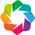

Shape of your Data Set loaded: (24192, 20)
############## C L A S S I F Y I N G  V A R I A B L E S  ####################
Classifying variables in data set...
    19 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Multi_Classification VISUALIZATION Started #####################


Row
    [0] WidgetBox
        [0] Select(name='y', options=['price', 'freight_value',...], value='price')
    [1] ParamFunction(function)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['price', 'freight_value',...], value='price')
        [1] Select(name='Y-Axis', options=['price', 'freight_value',...], value='freight_value')
        [2] Select(name='Color', options=['None', 'product_category...], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['customer_zip_code_prefix...], value='customer_zip_code_prefix'..., width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['product_height_cm', ...], value='product_height_cm', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['customer_zip_code_prefix...], value='customer_zip_code_prefix'...)
        [1] Select(name='Y-Axis', options=['price', 'freight_value',...], value='freight_value')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 11


In [11]:
# launch eda
eda(display_format = 'bokeh')

**CLASSIFICATION USECASE**

In [ ]:
best_classification_model = compare_models(fold=3,n_select=3)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9564,0.9953,0.9541,0.9565,0.9564,0.9411,0.9411,1.6633
rf,Random Forest Classifier,0.9494,0.9953,0.9470,0.9496,0.9494,0.9317,0.9317,3.0933
et,Extra Trees Classifier,0.9461,0.9945,0.9432,0.9463,0.9461,0.9272,0.9272,1.7500
dt,Decision Tree Classifier,0.9208,0.9475,0.9173,0.9206,0.9206,0.8930,0.8930,0.2567
gbc,Gradient Boosting Classifier,0.9001,0.9844,0.8956,0.9010,0.9005,0.8651,0.8652,12.1733
ada,Ada Boost Classifier,0.7263,0.8869,0.7178,0.7212,0.7228,0.6305,0.6311,1.3567
knn,K Neighbors Classifier,0.6623,0.8657,0.6457,0.6564,0.6561,0.5413,0.5433,0.7200
lda,Linear Discriminant Analysis,0.6314,0.8566,0.6171,0.6459,0.6353,0.5042,0.5063,0.1233
ridge,Ridge Classifier,0.6267,0.0000,0.6023,0.6176,0.6187,0.4932,0.4951,0.1100
lr,Logistic Regression,0.5689,0.7902,0.5423,0.5511,0.5367,0.4042,0.4205,11.8100


**EVALUATE MODELS**

In [ ]:
#evaluate Light Gradient Boosting Machine	
evaluate_model(best_classification_model[0])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
#evaluate Random Forest Classifier	
evaluate_model(best_classification_model[1])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
#evaluate Extra Trees Classifier	
evaluate_model(best_classification_model[2])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**BLEND MODELS**

In [ ]:
#blending 3 models
blender_top3 = blend_models(best_classification_model)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9622,0.9975,0.9600,0.9624,0.9623,0.9490,0.9490
1,0.9675,0.9979,0.9661,0.9683,0.9677,0.9562,0.9563
2,0.9622,0.9965,0.9605,0.9621,0.9622,0.9490,0.9490
3,0.9681,0.9971,0.9670,0.9683,0.9681,0.9570,0.9570
4,0.9610,0.9968,0.9601,0.9613,0.9611,0.9474,0.9474
5,0.9675,0.9970,0.9663,0.9675,0.9675,0.9561,0.9561
6,0.9598,0.9965,0.9575,0.9605,0.9599,0.9458,0.9460
7,0.9693,0.9980,0.9673,0.9693,0.9693,0.9585,0.9585
8,0.9587,0.9970,0.9562,0.9588,0.9587,0.9442,0.9442
9,0.9699,0.9976,0.9690,0.9700,0.9699,0.9593,0.9593


**TUNE MODEL**

In [ ]:
#tunning model
tuned_model = tune_model(blender_top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9610,0.9975,0.9588,0.9612,0.9611,0.9474,0.9474
1,0.9675,0.9979,0.9661,0.9683,0.9677,0.9562,0.9563
2,0.9616,0.9965,0.9599,0.9615,0.9615,0.9482,0.9482
3,0.9687,0.9972,0.9676,0.9688,0.9687,0.9578,0.9578
4,0.9610,0.9968,0.9601,0.9613,0.9611,0.9474,0.9474
5,0.9675,0.9971,0.9663,0.9675,0.9675,0.9561,0.9561
6,0.9598,0.9965,0.9575,0.9605,0.9599,0.9458,0.9460
7,0.9687,0.9980,0.9667,0.9687,0.9687,0.9577,0.9577
8,0.9587,0.9970,0.9562,0.9588,0.9587,0.9442,0.9442
9,0.9693,0.9976,0.9684,0.9694,0.9693,0.9585,0.9586


**DASHBOARD**

**REGRESSION USECASE**

**REGRESSION ON FREIGHT VALUE**

In [ ]:
from pycaret.regression import *

In [ ]:
clf = setup(data=test, target="freight_value", session_id=123, remove_outliers=True,normalize=True, remove_multicollinearity = True)

,Description,Value
0,session_id,123
1,Target,freight_value
2,Original Data,"(67740, 21)"
3,Missing Values,False
4,Numeric Features,17
5,Categorical Features,3
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(45046, 46)"


In [ ]:
best_model = compare_models(fold=3,n_select=3)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lightgbm,Light Gradient Boosting Machine,3.5342,55.8704,7.4697,0.6903,0.3043,0.4117,0.7833
rf,Random Forest Regressor,3.4428,57.8218,7.5991,0.6794,0.2932,0.4209,37.6833
et,Extra Trees Regressor,3.4248,59.4554,7.7060,0.6705,0.2957,0.4213,24.6300
gbr,Gradient Boosting Regressor,3.8998,64.5310,8.0281,0.6422,0.3267,0.4358,8.6533
knn,K Neighbors Regressor,4.3348,78.4478,8.8512,0.5653,0.3430,0.4551,35.7067
br,Bayesian Ridge,4.8098,84.3190,9.1805,0.5323,0.3636,0.4825,0.1867
lr,Linear Regression,4.8143,84.3373,9.1815,0.5322,0.3639,0.4827,1.6600
ridge,Ridge Regression,4.8141,84.3365,9.1815,0.5322,0.3639,0.4827,0.0800
lar,Least Angle Regression,4.8143,84.3373,9.1815,0.5322,0.3639,0.4827,0.0933
omp,Orthogonal Matching Pursuit,4.7855,85.7185,9.2564,0.5245,0.3633,0.4764,0.0800


In [ ]:
#Light Gradient Boosting Machine
evaluate_model(best_model[0])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
#Random Forest Regressor
evaluate_model(best_model[1])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
#Extra Trees Regressor
evaluate_model(best_model[2])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

**BLEND MODELS**

In [ ]:
#blending 3 models
blender_top3 = blend_models(best_model)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,3.1918,48.3548,6.9538,0.7104,0.2768,0.1977
1,3.3314,62.3176,7.8941,0.7067,0.2782,0.3277
2,3.1873,42.1301,6.4908,0.7471,0.2805,0.1660
3,3.1976,44.0503,6.6370,0.7352,0.2759,0.8468
4,3.3053,48.1718,6.9406,0.7228,0.2777,0.4557
5,3.3844,75.4793,8.6879,0.6551,0.2960,0.3448
6,3.4528,59.9698,7.7440,0.6600,0.2846,0.3232
7,3.1678,41.6018,6.4499,0.7523,0.3014,0.3454
8,3.2614,53.1083,7.2875,0.6607,0.3163,0.7747
9,3.4273,64.5173,8.0323,0.6711,0.3079,0.3899


**TUNE MODEL**

In [ ]:
#tunning model
tuned_model = tune_model(blender_top3)

**FINALIZE THE MODEL**

**DASHBOARD**

**REGRESSION FOR ESTIMATING DELIVERY TIME**

In [ ]:
clf = setup(data=testing, target="actual_delivery_timeline", session_id=123, remove_outliers=True,normalize=True, remove_multicollinearity = True)

,Description,Value
0,session_id,123
1,Target,actual_delivery_timeline
2,Original Data,"(67740, 20)"
3,Missing Values,False
4,Numeric Features,17
5,Categorical Features,2
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(45046, 18)"


**REGRESSION MODELS USING SKLEARN**

**TRAIN TEST SPLIT**

In [ ]:
testing

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(, y, test_size=0.2, random_state=42)

**LINEAR REGRESSION**

In [ ]:
from sklearn.linear_model import LinearRegression
# creating an object of LinearRegression class
LR = LinearRegression()
# fitting the training data
LR.fit(X_train,y_train)

LinearRegression()

In [ ]:
y_prediction =  LR.predict(X_test)
y_prediction

array([12.12123296,  9.11220876,  6.90677025, ..., -8.95894015,
        9.07020243, 22.09408716])

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,y_prediction)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,y_prediction))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,y_prediction)))

r2 score is 0.6590373599887461
mean_sqrd_error is= 30.31012412061343
root_mean_squared error of is= 5.505463115907093


**LASSO REGRESSION**

In [ ]:
from sklearn.linear_model import Lasso
lasso = Lasso(alpha=0.1)
lasso.fit(X_train, y_train)
lasso_pred = lasso.predict(X_test)
lasso.score(X_test, y_test)

0.6565011266259855

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,lasso_pred)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,lasso_pred))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,lasso_pred)))

r2 score is 0.6565011266259855
mean_sqrd_error is= 30.535584446769928
root_mean_squared error of is= 5.525901233895691


**Ridge Regression**

In [ ]:
from sklearn.linear_model import Ridge
ridge = Ridge(alpha=0.1)
ridge.fit(X_train, y_train)
ridge_pred = ridge.predict(X_test)
ridge.score(X_test, y_test)

0.6590373452446766

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,ridge_pred)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,ridge_pred))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,ridge_pred)))

r2 score is 0.6590373452446766
mean_sqrd_error is= 30.31012543129831
root_mean_squared error of is= 5.505463234942026


In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,y_prediction)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,y_prediction))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,y_prediction)))

r2 score is 0.6590373599887461
mean_sqrd_error is= 30.31012412061343
root_mean_squared error of is= 5.505463115907093


**POLYNOMIAL REGRESSION**

In [ ]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression
degree=2
polyreg=make_pipeline(PolynomialFeatures(degree),LinearRegression())
polyreg.fit(X_train,y_train)

Pipeline(steps=[('polynomialfeatures', PolynomialFeatures()),
                ('linearregression', LinearRegression())])

In [ ]:
y_prediction =  polyreg.predict(X_test)
y_prediction

array([12.25263148,  6.2558147 ,  5.63406002, ...,  2.11446912,
        9.98462925, 21.17514324])

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,y_prediction)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,y_prediction))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,y_prediction)))

r2 score is 0.7687723842707918
mean_sqrd_error is= 20.55514860113261
root_mean_squared error of is= 4.533778622863341


**NEURAL NETWORK**

In [ ]:
from sklearn.neural_network import MLPRegressor
from sklearn.datasets import make_regression

regr = MLPRegressor(random_state=1, max_iter=500).fit(X_train, y_train)

array([ 9.48075682,  5.25047394,  6.86902966, ..., 11.91555863,
        9.72945846, 18.93477   ])

In [ ]:
y_prediction = regr.predict(X_test)

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,y_prediction)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,y_prediction))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,y_prediction)))

r2 score is 0.8583010970335043
mean_sqrd_error is= 12.596427973831632
root_mean_squared error of is= 3.54914468200884


**Support Vector Regression**

In [ ]:
from sklearn.svm import SVR
svr = SVR().fit(X_train, y_train)

In [ ]:
y_prediction = svr.predict(X_test)

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,y_prediction)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,y_prediction))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,y_prediction)))

r2 score is 0.7269795688021208
mean_sqrd_error is= 24.27035160449832
root_mean_squared error of is= 4.926494859887537


**Random Forest Regressor**

In [ ]:
from sklearn.ensemble import RandomForestRegressor
rfr = RandomForestRegressor(max_depth=7).fit(X_train, y_train)
y_prediction = rfr.predict(X_test)

In [ ]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
# predicting the accuracy score
score=r2_score(y_test,y_prediction)
print("r2 score is",score)
print("mean_sqrd_error is=",mean_squared_error(y_test,y_prediction))
print("root_mean_squared error of is=",np.sqrt(mean_squared_error(y_test,y_prediction)))

r2 score is 0.8143859890051436
mean_sqrd_error is= 16.500293731868428
root_mean_squared error of is= 4.062055358050704


**CLASSIFICATION MODELS USING SKLEARN**